In [12]:
import sklearn
import os
import numpy as np
import pandas as pd
import pickle as pkl
import matplotlib
import matplotlib.cm as cm
import matplotlib.pyplot as plt
%matplotlib inline

from itertools import product
from collections import Counter, defaultdict

import time
from sklearn.cluster import KMeans, spectral_clustering
from sklearn.feature_extraction.image import img_to_graph
from sklearn.preprocessing import maxabs_scale, normalize
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.feature_extraction.text import CountVectorizer

from skimage import io, transform, color

<a id='table_of_contents'></a>
# Лабораторная работа 1. Обучение без учителя.
* [1. Кластеризация](#clusterization)
    * [1.1 Общие замечания о кластеризации](#notes_on_clusterization)
    * [1.2 Кластеризация изображений цифр с помощью алгоритма KMeans](#digits_clusterization)
        * [1.2.1 Задание 1 [0.5 балла]](#cl_task1)
        * [1.2.2 Задание 2](#cl_task2)
            * [1.2.2.1 [1 балл]](#cl_task21)
            * [1.2.2.2 [0.5 балла]](#cl_task22)
* [2. Разделение изображения на семантические компоненты](#image_segmentation)
    * [2.1 Задание 1 [1 балл]. Визуализация результатов сегментации](#seg_task1)
    * [2.2 Задание 2 [1 балл]. Варьирование параметров алгоритмов](#seg_task2)
* [3. Тематическое моделировие](#tematic_modeling)
    * [3.1 Рассуждения на тему тематического моделирования](#discussion_on_topic_modeling)
    * [3.2 Реализация ЕМ-алгоритма для модели PLSA и его применение](#plsa_and_application)
        * [3.2.1 Задание 1 [3 балла]](#plsa_task1)
        * [3.2.2 Задание 2 [0.5 балла]](#plsa_task2)
        * [3.2.3 Задание 3 [0.5 балла]](#plsa_task3)
    * [3.3 Модель LDA и визуализация](#lda_and_visualization)
        * [3.3.1 Задание 1 [1 балла]](#lda_task1)
        * [3.3.2 Задание 2 [1 балл]](#lda_task2)

<a id='clusterization'></a>
# 1. Кластеризация<sup>[содержание](#table_of_contents)</sup>

<a id='notes_on_clusterization'></a>
## 1.1 Общие замечания о кластеризации<sup>[содержание](#table_of_contents)</sup>

![Digits](https://www.dropbox.com/s/nrjiahdbpswd63y/digits.png?dl=1)

Задача [кластеризации](https://en.wikipedia.org/wiki/Cluster_analysis) данных является одним из примеров задач обучения "без учителя". Она заключается в разбиении множества объектов на заданное число кластеров, при этом предполагается, что внутри одного кластера будут находиться похожие между собой объекты. Одним из примеров методов кластеризации является алгоритм [KMeans](https://en.wikipedia.org/wiki/K-means_clustering).

### Выбор числа кластеров

Для некоторых алгоритмов кластеризации число кластеров является гиперпараметром (например, в случае KMeans). Поэтому для выбора количества кластеров может быть испоьзован следующий подход: при фиксированной метрики качества для разного числа кластеров вычисляют кластеризацию и выбирают то значение, начиная с которого качество "стабилизируется".

### Метрики качества

Оценивание качества построенной кластеризации не всегда тривиальная задача, так как следует учитывать такие факты как:
 - объекты одного класса должны быть более похоже, чем объекты других кластеров, относительно некоторой заданной метрики похожести
 - метрика не должна учитывать абсолютные значения меток объектов, попавших в кластер (в случае, если истинные метоки известны)

При выполнении задания для оценки качества получившейся кластеризации воспользуемся следующими метриками:
 - [Homogeneity и Completeness](http://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure) 
 - [Adjusted Rand index](http://scikit-learn.org/stable/modules/clustering.html#adjusted-rand-index) 
 - [Silhouette Coefficient](http://scikit-learn.org/stable/modules/clustering.html#silhouette-coefficient)

<a id='digits_clusterization'></a>
## 1.2. Кластеризация изображений цифр с помощью алгоритма KMeans<sup>[содержание](#table_of_contents)</sup>

Загрузка набора данных [digits](http://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_digits.html). 

In [27]:
from sklearn.datasets import load_digits
digits = load_digits()
n_digits, n_pixels = digits.data.shape
print('Number of digits = {}, number of pixels per digit = {}'.format(n_digits, n_pixels))
image_height = 8
image_width = 8

Number of digits = 1797, number of pixels per digit = 64


Ради интереса, отрисуем первые 10 изображений.

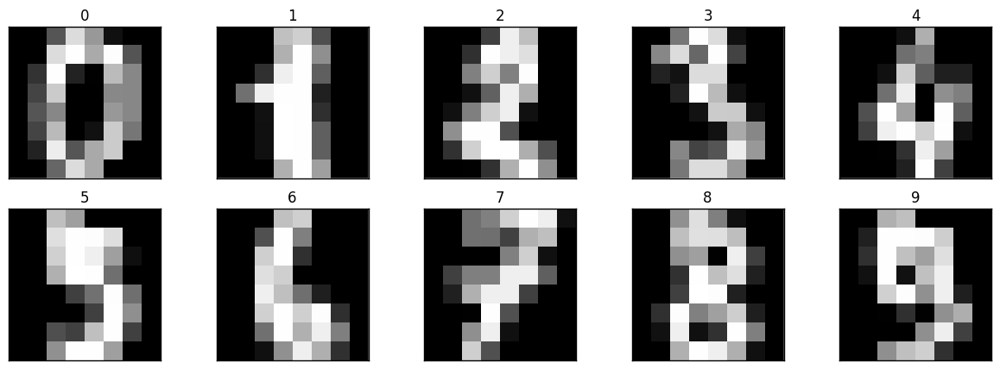

In [28]:
def plot_images(images, titles=None, figsize=(15, 5), n_cols=5):
    n_images = len(images)
    if titles is None:
        titles = ['' for n_image in range(n_images)]
    n_rows = np.ceil(1.0 * n_images / n_cols)
    fig = plt.figure(figsize=figsize)
    for n_image in range(n_images):
        plt.subplot(n_rows, n_cols, n_image + 1)
        plt.xticks([]); plt.yticks([])
        plt.gray()
        plt.imshow(images[n_image], interpolation='none')
        plt.title(titles[n_image])
        
n_images = 10
plot_images(digits.images[:n_images], digits.target[:n_images])

Всего в наборе данных digits имеется 1797 изображений цифр от 0 до 9 размера 8x8 пикселей. Значение цифры определяет ее принадлежность к кластеру, т.е. для данного набора фактически имеем 10 кластеров. 

Код ниже представляет изображения в виде векторов длины 64. Кроме того, производится случайное перемешивание изображений перед последующим применением алгоритмов кластеризации.

In [29]:
np.random.seed(157)
permutation = np.random.permutation(n_digits)
X = digits.data[permutation]
labels_true = digits.target[permutation]
print(X.shape)

(1797, 64)


<a id='cl_task1'></a>
### 1.2.1 Задание 1 [0.5 балла]<sup>[содержание](#table_of_contents)</sup>
Кластеризуйте изображения при помощи алгоритма [KMeans](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html), подобрав число кластеров для некоторой фиксированной метрики из указанных выше. Рассмотрите различные способы выбора начального приближения (параметр *init*). Оцените качество получившейся кластеризации используя все описанные выше метрики. Визуализируйте изображения, соответствующие центроидам лучшей кластеризации.

#### 1.2.1.1 Кластеризация изображений при помощи алгоритма KMeans<sup>[содержание](#table_of_contents)</sup>

Посмотрим на то, как значения используемых метрик зависят от числа кластеров. Для этого применим алгоритм KMeans с разным числом кластеров. Ниже получившиеся значения метрик изображены графически.

In [32]:
# Обертки для функций подсчета метрик (для приведения к общему интерфейсу)
def completeness_score(X, labels_true, labels_pred):
    return sklearn.metrics.completeness_score(labels_true, labels_pred)
def adjusted_rand_score(X, labels_true, labels_pred):
    return sklearn.metrics.adjusted_rand_score(labels_true, labels_pred)
def silhouette_score(X, labels_true, labels_pred):
    return sklearn.metrics.silhouette_score(X, labels_pred, metric='euclidean')

metrics = {'C&H': completeness_score, 'ARI': adjusted_rand_score, 'SILH': silhouette_score}

def run_kmeans(X, n_clusters, random_state, **params):
    """Просто запускает алгоритм KMeans. Возвращает вектор меток и центры кластеров."""
    kmeans_model = KMeans(n_clusters=n_clusters, random_state=random_state, **params)
    kmeans_model.fit(X)
    labels_pred = kmeans_model.labels_
    cluster_centers = kmeans_model.cluster_centers_
    return labels_pred, cluster_centers

def get_single_kmeans_metrics(X, n_clusters, labels_true, metrics, random_state, **params):
    """Получает на вход список функций для вычесления метрик. Запускает алгоритм KMeans и вычисляет значения
    поданных на вход метрик"""
    labels_pred, cluster_centers = run_kmeans(X, n_clusters, random_state, **params)
    metric_values = {}
    for metric_name, metric_function in metrics.items():
        metric_values[metric_name] = metric_function(X, labels_true, labels_pred)
    return metric_values

def get_kmeans_metrics(X, n_clusters_range, labels_true, metrics, random_state, verbose=False, **params):
    """Получает на вход список функций для вычесления метрик. Запускает алгоритм KMeans и вычисляет значения
    поданных на вход метрик. В отличие от get_single_kmeans_metrics запускает KMeans для нескольких занчений
    числа кластеров n_clusters"""
    all_metric_values = {}
    for metric_name in metrics:
        all_metric_values[metric_name] = np.zeros(len(n_clusters_range))

    for n_clusters in n_clusters_range:
        metric_values = get_single_kmeans_metrics(X, n_clusters, labels_true, metrics, random_state, **params)
        for metric_name in metric_values:
            all_metric_values[metric_name][n_clusters - min(n_clusters_range)] = metric_values[metric_name] 
        if verbose:
            print('n_clusters = {:2d}, C&H = {C&H:5.4f}, ARI = {ARI:5.4f}, SILH = {SILH:4.4f}'.format(
                    n_clusters, **metric_values))
    return all_metric_values

In [33]:
min_n_clusters = 2
max_n_clusters = 20
random_state = 1
n_clusters_range = range(min_n_clusters, max_n_clusters + 1)
all_metric_values = get_kmeans_metrics(X, n_clusters_range, labels_true, metrics, random_state, verbose=True)

n_clusters =  2, C&H = 0.8471, ARI = 0.1381, SILH = 0.1183
n_clusters =  3, C&H = 0.6293, ARI = 0.2213, SILH = 0.1265
n_clusters =  4, C&H = 0.6055, ARI = 0.2858, SILH = 0.1280
n_clusters =  5, C&H = 0.7232, ARI = 0.3912, SILH = 0.1382
n_clusters =  6, C&H = 0.6785, ARI = 0.3879, SILH = 0.1506
n_clusters =  7, C&H = 0.7300, ARI = 0.4902, SILH = 0.1633
n_clusters =  8, C&H = 0.7605, ARI = 0.5752, SILH = 0.1785
n_clusters =  9, C&H = 0.7469, ARI = 0.5953, SILH = 0.1890
n_clusters = 10, C&H = 0.7479, ARI = 0.6701, SILH = 0.1824
n_clusters = 11, C&H = 0.7533, ARI = 0.6712, SILH = 0.1867
n_clusters = 12, C&H = 0.7485, ARI = 0.7117, SILH = 0.1831
n_clusters = 13, C&H = 0.7441, ARI = 0.7063, SILH = 0.1851
n_clusters = 14, C&H = 0.7354, ARI = 0.7040, SILH = 0.1875
n_clusters = 15, C&H = 0.7111, ARI = 0.6492, SILH = 0.1718
n_clusters = 16, C&H = 0.7175, ARI = 0.6696, SILH = 0.1870
n_clusters = 17, C&H = 0.6945, ARI = 0.6024, SILH = 0.1515
n_clusters = 18, C&H = 0.6847, ARI = 0.6008, SILH = 0.16

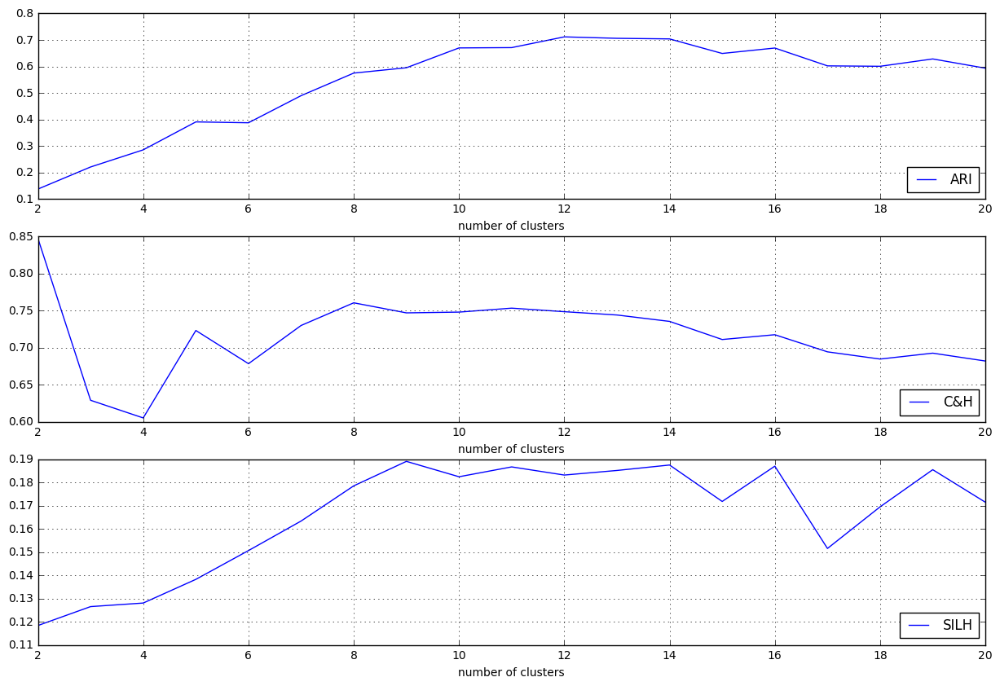

In [42]:
fig = plt.figure(figsize=(15, 10))
n_metrics = len(metrics)
for n_metric, metric_name in enumerate(sorted(all_metric_values)):
    plt.subplot(n_metrics, 1, n_metric + 1)
    plt.plot(n_clusters_range, all_metric_values[metric_name], label=metric_name)
    plt.legend(loc='lower right')
    plt.grid()
    plt.xlabel('number of clusters')

Видно, что метрики выходят на максимальное значение в районе 9-11 кластеров.

#### 1.2.1.2 Рассмотрение различных способов выбора начального приближения<sup>[содержание](#table_of_contents)</sup>
Теперь исследуем поведение алгоритма кластеризации KMeans в зависимости от способа выбора начального приближения. Всего KMeans предлагает три подхода к выбору начального приближения:
* kmeans++
* random
* array (ручное задание центров кластеров)

Ниже приводится запуск алгоритма KMeans с использованием всех трех походов к выбору начальных центров. Для оценки влияния инициализации выводятся значения метрик качества кластеризации и значения времен работы алгоритма. В случае "ручного" задания центров, в качестве таковых выбираются первые n_clusters изображений.

In [112]:
n_clusters = 10
random_state = 1
inits = ['k-means++', 'random', digits.data[:n_clusters]]
for init_number, init in enumerate(inits):
    start = time.time()
    metric_values = get_single_kmeans_metrics(X, n_clusters, labels_true, metrics, random_state, init=init, 
                                              max_iter=1000, n_init=20)
    end = time.time()
    print('\'{}\' works {} s'.format(init_number, end - start))
    print('n_clusters = {:2d}, completness = {C&H:5.4f}, adjusted_rand = {ARI:5.4f}, silhouette = {SILH:4.4f}'.format(
         n_clusters, **metric_values))

'0' works 0.8092670440673828 s
n_clusters = 10, completness = 0.7479, adjusted_rand = 0.6701, silhouette = 0.1824
'1' works 0.7935702800750732 s
n_clusters = 10, completness = 0.7450, adjusted_rand = 0.6639, silhouette = 0.1822


/home/alexander/anaconda2/envs/py35/lib/python3.5/site-packages/sklearn/cluster/k_means_.py:821: RuntimeWarning: Explicit initial center position passed: performing only one init in k-means instead of n_init=20
  n_jobs=self.n_jobs)


'2' works 0.5538606643676758 s
n_clusters = 10, completness = 0.7600, adjusted_rand = 0.6524, silhouette = 0.1879


Стоит отметить, что при использовании подходов "k-means++" и "random", алгоритм KMeans по сути запускается несколько раз (точное число задется параметром n_iter). При этом в качестве итогового ответа выдается лучшая кластеризация. При ручном же задании начальных центров кластеров алгоритм KMeans запускается только один раз. Если начальные центры кластеров заданы относительно хорошо, то такой подход позволяет уменьшить время работы алгоритма особенно в случае, когда число объектов велико. Однако если центры выбраны неточно, то возможны потери как во времени работы алгоритма (потребуется больше времени для сходимости), так и в качестве кластеризации. 

В рассматриваемом случае, когда кластеры представлены множеством изображений цифр от 0 до 9, можно задать центры кластеров как это сделано выше, выбрав некоторые изображения цифр в качестве центров. Такой выбор тривиален в случае, когда кластеров равно 10 (достаточно взять любые 10 изображений цифр от 0 до 9).

#### 1.2.1.3 Визуализация изображений, соответствующих центроидам лучшей кластеризации<sup>[содержание](#table_of_contents)</sup>

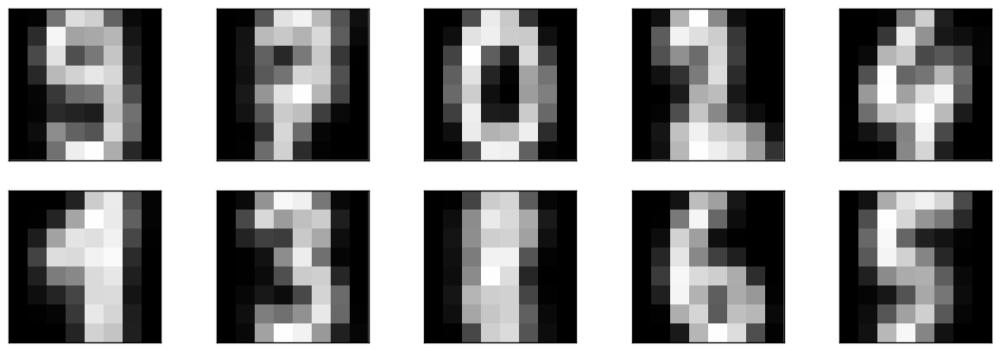

In [113]:
n_clusters = 10
random_state = 1
labels_pred, cluster_centers = run_kmeans(X, n_clusters=n_clusters, random_state=random_state)
cluster_centers = [cluster_center.reshape((image_height, image_width)) for cluster_center in cluster_centers]
plot_images(cluster_centers)

<a id='cl_task2'></a>
### 1.2.2 Задание 2<sup>[содержание](#table_of_contents)</sup>

Не всегда бывает удобно работать с полной матрицей объект-признак, например, для случая визуализации данных. В одной из предыдущих лабораторных работ был рассмотрен метод уменьшения размерности *PCA*. Вот [здесь](http://scikit-learn.org/stable/auto_examples/manifold/plot_lle_digits.html#example-manifold-plot-lle-digits-py) было показано сравнение различных способов сжатия размерности для проекции на плоскость. На изображениях видно, что некоторые преобразования дают неплохую картину и одинаковые цифры расположены близко друг к другу. Посмотрим, поможет ли это на практике.

<a id='cl_task21'></a>
#### 1.2.2.1 [1 балл]<sup>[содержание](#table_of_contents)</sup>
Примените преобразования [PCA](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) и [tSNE](http://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html) (для числа компонент 2 и 10) и сравните результаты с предыдущими. Нашелся ли метод кластеризации, превосходящий другие по всем метрикам? Являются ли все три метрики согласованными? Можете ли вы объяснить почему?

Для случая двух компонент (n_components=2) результаты проекции можно изобразить графически на плоскости, где точка соответствует объекту, а цвет точки - кластеру, к которому принадлежит объект.

In [35]:
def plot_scatter(X, y, figsize=(7, 7), title=''):
    def get_colors(labels, cmap_name='rainbow'):
        counted = Counter(labels)
        n_colors = len(counted)
        label2color = {}
        for color, label in enumerate(sorted(counted)):
            label2color[label] = (color + 1) / n_colors
        cmap = plt.get_cmap(cmap_name)
        colors = np.array([cmap(label2color[label]) for label in labels])
        return colors
    plt.figure(figsize=figsize)
    plt.scatter(X[:, 0], X[:, 1], color=get_colors(y))
    plt.title(title)

In [36]:
if os.path.isfile('X_pca2.pkl'):
    X_pca2 = pkl.load(open('X_pca2.pkl', 'rb'))
else:
    X_pca2 = PCA(n_components=2).fit_transform(X)
    pkl.dump(X_pca2, open('X_pca2.pkl', 'wb'))
    
if os.path.isfile('X_tsne2.pkl'):
    X_tsne2 = pkl.load(open('X_tsne2.pkl', 'rb'))
else:
    X_tsne2 = TSNE(n_components=2, random_state=17).fit_transform(X)
    pkl.dump(X_tsne2, open('X_tsne2.pkl', 'wb'))

if os.path.isfile('X_pca10.pkl'):
    X_pca10 = pkl.load(open('X_pca10.pkl', 'rb'))
else:
    X_pca10 = PCA(n_components=2).fit_transform(X)
    pkl.dump(X_pca10, open('X_pca10.pkl', 'wb'))    

if os.path.isfile('X_tsne10.pkl'):
    X_tsne10 = pkl.load(open('X_tsne10.pkl', 'rb'))
else:
    X_tsne10 = TSNE(n_components=2, random_state=17).fit_transform(X)
    pkl.dump(X_tsne10, open('X_tsne10.pkl', 'wb'))

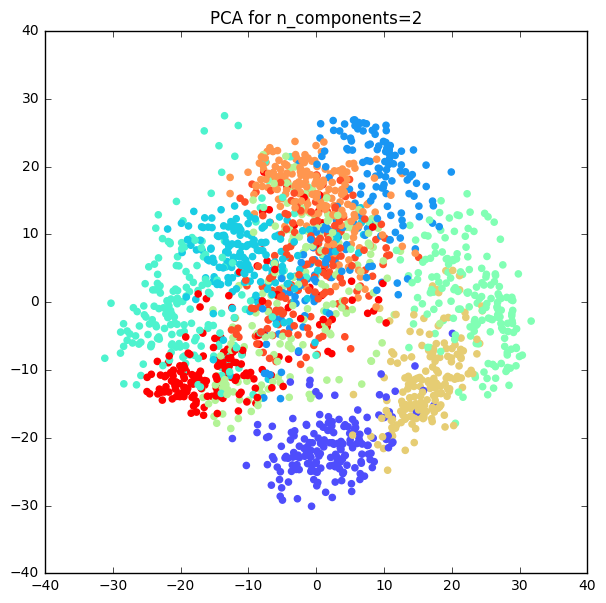

In [37]:
plot_scatter(X_pca2, labels_true, title='PCA for n_components=2')

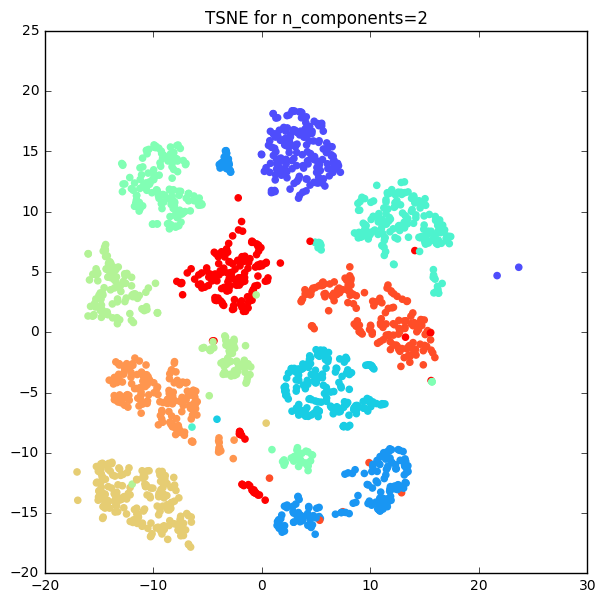

In [38]:
plot_scatter(X_tsne2, labels_true, title='TSNE for n_components=2')

In [39]:
all_metric_values_init = get_kmeans_metrics(X, n_clusters_range, labels_true, metrics, random_state)
all_metric_values_pca2 = get_kmeans_metrics(X_pca2, n_clusters_range, labels_true, metrics, random_state)
all_metric_values_tsne2 = get_kmeans_metrics(X_tsne2, n_clusters_range, labels_true, metrics, random_state)
all_metric_values_pca10 = get_kmeans_metrics(X_pca10, n_clusters_range, labels_true, metrics, random_state)
all_metric_values_tsne10 = get_kmeans_metrics(X_tsne10, n_clusters_range, labels_true, metrics, random_state)

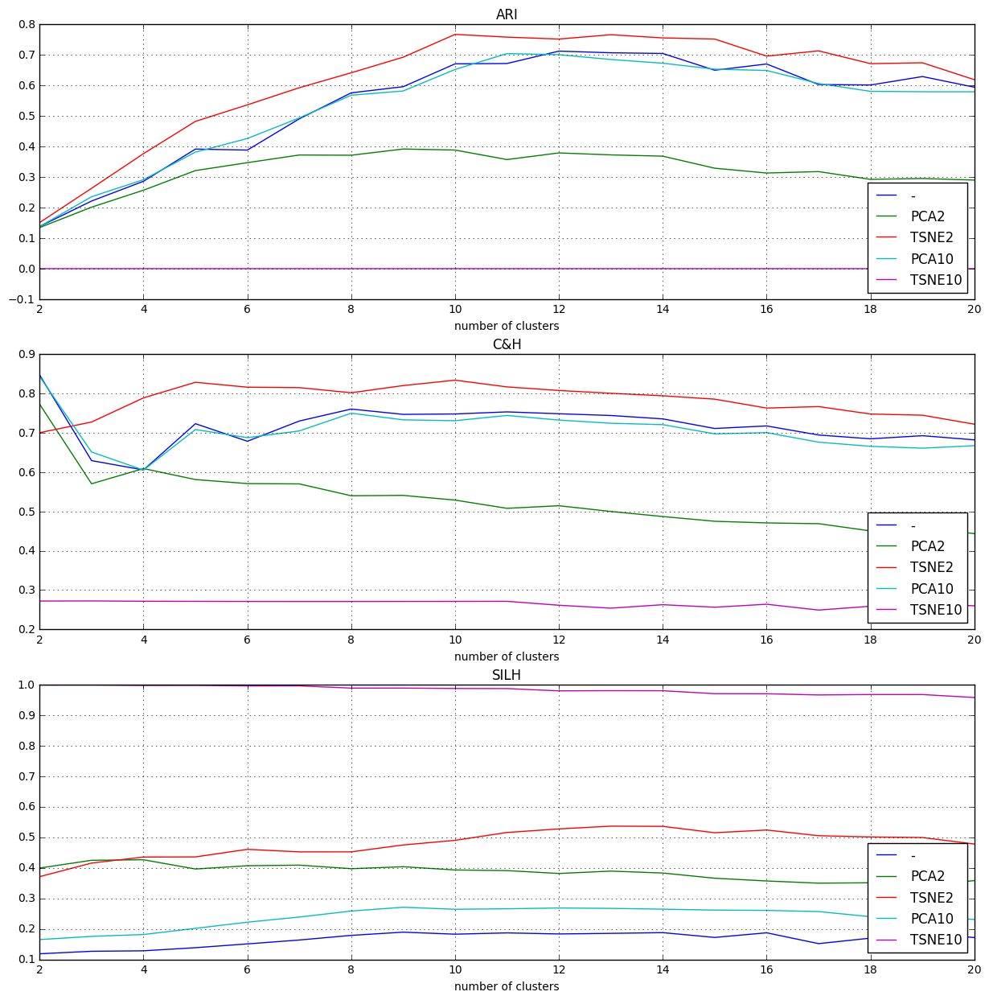

In [41]:
fig = plt.figure(figsize=(15, 15))
n_metrics = len(metrics)
for n_metric, metric_name in enumerate(sorted(all_metric_values)):
    plt.subplot(n_metrics, 1, n_metric + 1)
    plt.plot(n_clusters_range, all_metric_values_init[metric_name], label='-')
    plt.plot(n_clusters_range, all_metric_values_pca2[metric_name], label='PCA2')
    plt.plot(n_clusters_range, all_metric_values_tsne2[metric_name], label='TSNE2')
    plt.plot(n_clusters_range, all_metric_values_pca10[metric_name], label='PCA10')
    plt.plot(n_clusters_range, all_metric_values_tsne10[metric_name], label='TSNE10')
    plt.legend(loc='lower right')
    plt.grid()
    plt.title(metric_name)
    plt.xlabel('number of clusters')

В целом видно, что в общем случае рассматриваемые метрики не являются согласованными, т.е. если один алгоритм превосходит другой в терминах некоторой метрики, то это не значит, что он превосходит его и по другим метрикам. В целом, наилучшим образом ведет себя кластеризация для TSNE2. Впрочем, этого и следовало ожидать, если принять во внимание ранее полученному графическому изображению результата преобразования TSNE для числа компонент равного 2-м, где точки очень хорошо разделены на группы, соответствующие одним и тем же цифрам.

Стоит отметить, что значение метрики SILH для TSNE10 практически равно 1. Это может быть связано с тем, что TSNE-преобразование представляет множество объектов в виде групп близко расположенных точек. В результате последующего примененения алгоритма KMeans близкорасположенные точки получают идентичные метки. Однако при этом среднее расстояние от точки до всех точек ее кластера близко к нулю. В то время как расстояние до соседних кластеров значительно больше. Как следствие, значение метрики SILH согласно ее определению становится близко к 1. [Ниже](#SILH) данный факт демонстрируется явно.

Одновременно и достоинство и недостаток метрики SILH состоит в том, что она не требует знания истинных классов объектов. Что же касается метрик ARI и C&H, то они более аккуратно отображают истинное качество кластеризация, используя информацию об истинной принадлежности объектов к классам. В целом обе метрики растут, с ростом числа объектов одного класса попавших в один кластер, и ростом числа объектов разных классов попавших, соответственно, в разные кластеры. Потому они более адекватно отображают качество кластеризации, тогда как при определенных условиях (упомянутых выше) SILH метрика может давать совершенно некорректную информацию.

<a id='cl_task22'></a>
#### 1.2.2.2 [0.5 балла]<sup>[содержание](#table_of_contents)</sup>
Визуализируйте несколько изображений, которые во всех случаях были отнесены к неправильному кластеру (объект назовем ошибочно отнесенным, если он имеет иную метку класса, нежели большая часть объектов в кластере). Можете ли вы пояснить почему так произошло?

In [43]:
n_clusters = 10
random_state = 1
all_labels_pred = {}
all_cluster_centers = {}
all_labels_pred['init'], all_cluster_centers['init'] = run_kmeans(X, n_clusters, random_state, n_init=10)
all_labels_pred['pca2'], all_cluster_centers['pca2'] = run_kmeans(X_pca2, n_clusters, random_state, n_init=10)
all_labels_pred['tsne2'], all_cluster_centers['tsne2'] = run_kmeans(X_tsne2, n_clusters, random_state, n_init=10)
all_labels_pred['pca10'], all_cluster_centers['pca10'] = run_kmeans(X_pca10, n_clusters, random_state, n_init=10)
all_labels_pred['tsne10'], all_cluster_centers['tsne10'] = run_kmeans(X_tsne10, n_clusters, random_state, n_init=10)

<a id='SILH'></a>
**Объяснение близости метрики SILH к единице для преобразования TNSE10**

In [66]:
def get_average_distance(X, x):
    x = x.reshape((1, -1))
    return np.mean(np.sqrt(np.sum((X - x) ** 2, axis=1)))

tsne10_labels = all_labels_pred['tsne10']
tsne10_centers = all_cluster_centers['tsne10']
n_clusters = len(Counter(tsne10_labels))
average_distances = np.zeros((n_clusters, n_clusters))
for n_cluster1, n_cluster2 in product(range(n_clusters), range(n_clusters)):
    if n_cluster1 > n_cluster2:
        continue
    center1 = tsne10_centers[n_cluster1]
    points2 = X_tsne10[tsne10_labels == n_cluster2]
    average_distances[n_cluster1, n_cluster2] = get_average_distance(points2, center1)
    average_distances[n_cluster2, n_cluster1] = average_distances[n_cluster1, n_cluster2]
for i in range(n_clusters):
    print(('{:.3e} ' * n_clusters).format(*average_distances[i]))

5.286e+01 7.437e+05 7.075e+05 2.505e+05 2.428e+05 7.731e+04 7.459e+04 1.331e+04 1.331e+04 1.052e+04 
7.437e+05 0.000e+00 1.450e+06 7.299e+05 8.368e+05 7.273e+05 7.641e+05 7.483e+05 7.386e+05 7.446e+05 
7.075e+05 1.450e+06 0.000e+00 8.038e+05 6.873e+05 7.330e+05 6.929e+05 7.034e+05 7.125e+05 7.069e+05 
2.505e+05 7.299e+05 8.038e+05 0.000e+00 4.927e+05 2.720e+05 2.510e+05 2.566e+05 2.453e+05 2.439e+05 
2.428e+05 8.368e+05 6.873e+05 4.927e+05 0.000e+00 2.461e+05 2.628e+05 2.366e+05 2.492e+05 2.496e+05 
7.731e+04 7.273e+05 7.330e+05 2.720e+05 2.461e+05 0.000e+00 1.517e+05 7.781e+04 7.857e+04 7.306e+04 
7.459e+04 7.641e+05 6.929e+05 2.510e+05 2.628e+05 1.517e+05 0.000e+00 7.657e+04 7.547e+04 8.012e+04 
1.331e+04 7.483e+05 7.034e+05 2.566e+05 2.366e+05 7.781e+04 7.657e+04 0.000e+00 2.660e+04 1.947e+04 
1.331e+04 7.386e+05 7.125e+05 2.453e+05 2.492e+05 7.857e+04 7.547e+04 2.660e+04 0.000e+00 1.398e+04 
1.052e+04 7.446e+05 7.069e+05 2.439e+05 2.496e+05 7.306e+04 8.012e+04 1.947e+04 1.398e+04 0

Массив выше содержит средние расстояния от центров кластеров до точек остальных кластеров (включая самого себя). Видно, что среднее расстояние до точек внутри кластера практически нулевое (диагональ в изображенной выше матрице), тогда как до точек остальных кластеров очень велико, что и объясняет почти единичное значение метрики SILH.

**Нахождение ошибочно классифицированных объектов**

In [159]:
def find_erroneous_objects(labels_true, labels_pred):
    cluster_labels = sorted(list(Counter(labels_true).keys()))
    most_frequent_labels = {}
    erroneous_objects = []
    for label in cluster_labels:
        # Нахождение индексов объектов, принадлежащих кластеру с меткой label
        label_indices = np.where(labels_true == label)[0] 
        
        # Нахождение самой частой предсказанной метки в кластере с меткой label
        counted_labels_pred = Counter(labels_pred[label_indices])
        most_frequent_label = sorted(counted_labels_pred.items(), key=lambda x: -x[1])[0][0]
        for index in label_indices:
            if labels_pred[index] != most_frequent_label:
                erroneous_objects.append(index)
    return erroneous_objects

In [160]:
erroneous_digits = list(range(n_digits))
for i in all_labels_pred:
    next_erroneous_digits = find_erroneous_objects(labels_true, all_labels_pred[i])
    erroneous_digits = list(set(erroneous_digits).intersection(next_erroneous_digits))

In [161]:
def plot_images(images, n_cols=5, figsize=(8, 20), titles=None):
    n_images = len(images)
    if titles is None:
        titles = ['' for n_image in range(n_images)]
    n_rows = np.ceil(1.0 * n_images / n_cols)
    fig = plt.figure(figsize=figsize)
    for n_image in range(n_images):
        plt.subplot(n_rows, n_cols, n_image + 1)
        plt.xticks([]); plt.yticks([])
        plt.imshow(images[n_image], interpolation='none')
        plt.title(titles[n_image])

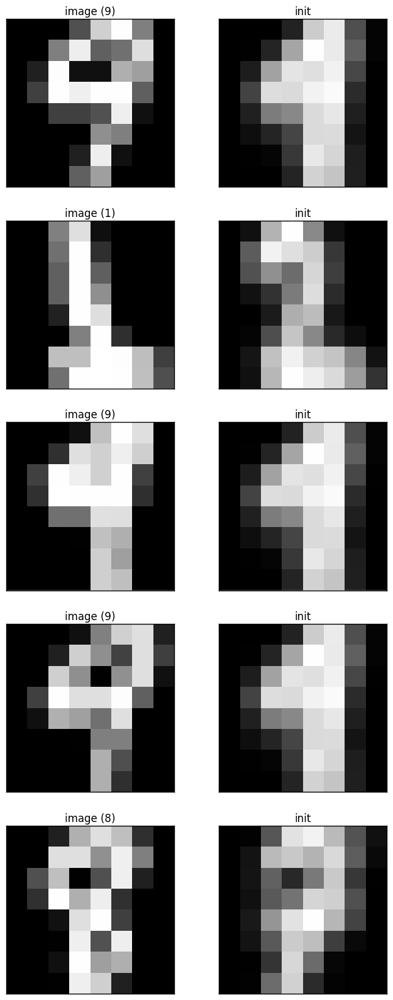

In [162]:
n_erroneous_digits=5
digits_to_plot = []
titles = []
for n_digit in erroneous_digits[:n_erroneous_digits]:
    digits_to_plot.append(X[n_digit].reshape((8, 8)))
    label_pred = all_labels_pred['init'][n_digit]
    cluster_center = all_cluster_centers['init'][label_pred]
    digits_to_plot.append(cluster_center.reshape((8, 8)))
    titles += ['image (' + str(labels_true[n_digit]) + ')', 'init']
plot_images(digits_to_plot, n_cols=2, titles=titles)

Ошибочное отнесение к кластерам изображенных выше цифр во всех способах кластеризации можно объяснить тем, что данные изображения обладают низким качеством, так что даже для человека ответ на вопрос, какие именно цифры содержат эти изображения, не является однозначным.

<a id='image_segmentation'></a>
# 2 Разделение изображения на семантические компоненты<sup>[содержание](#table_of_contents)</sup>

![RedPanda](http://imgur.com/6Aa52Lm.png)

Алгоритмы кластеризации могут применяться в самых разных задачах. Например, в анализе изображений есть задача разделения изображения на семантические компоненты, которую можно решать в том числе с помощью алгоритмов кластеризации. 

Начнем с загрузки [изображений](https://www.dropbox.com/s/ybnvkemeus9wupe/images.zip?dl=0).

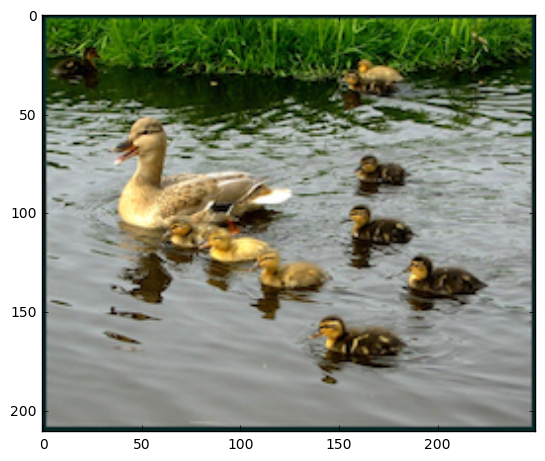

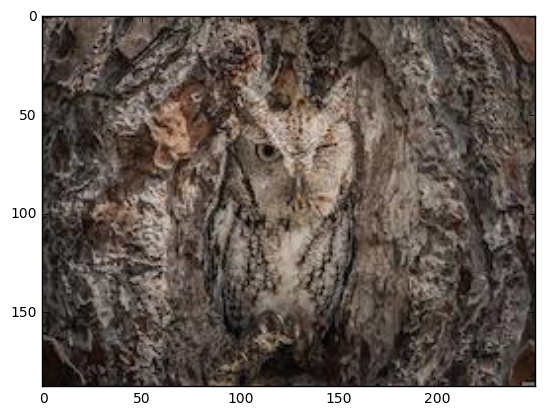

In [6]:
directory = 'images/'
image_names = ['ducks', 'owl']
figsize=(10, 10)
n_images = len(image_names)
images = {}
for n_image, image_name in enumerate(image_names):
    images[image_name] = io.imread(directory + image_name + '.jpg')
    fig = plt.figure(figsize=(14, 7))
    plt.subplot(1, n_images, n_image + 1)
    plt.imshow(images[image_name])

Ради интереса, посмотрим на 3D гистограмму распределения цветов на изображениях.

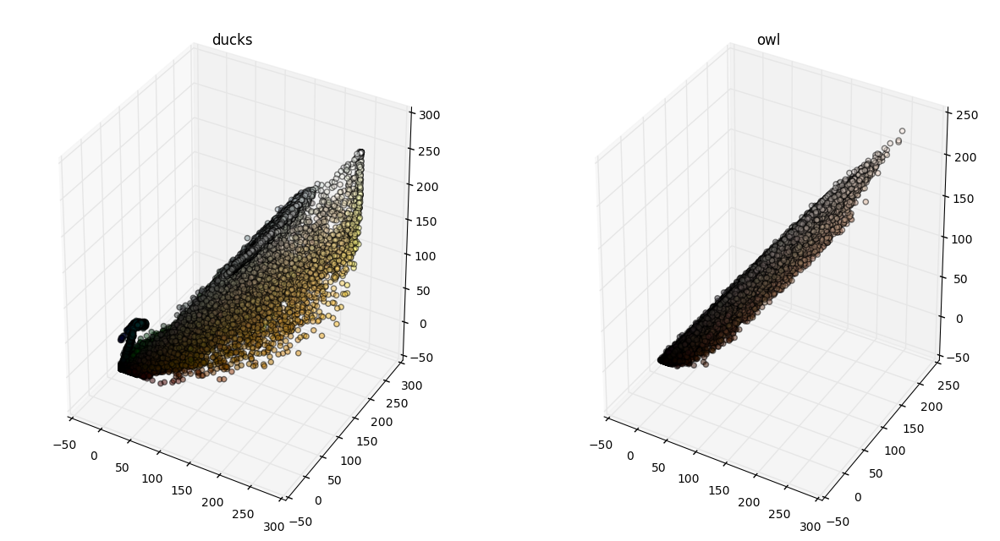

In [164]:
from mpl_toolkits.mplot3d import Axes3D
n_images = len(images)
fig = plt.figure()
for n_image, image_name in enumerate(sorted(images)):
    image = images[image_name]
    points = image.reshape((image.shape[0] * image.shape[1], -1))
    ax = fig.add_subplot(1, n_images, n_image + 1, projection='3d')
    ax.scatter(points[:, 0], points[:, 1], points[:, 2], c=points / 255, alpha=0.5)
    ax.set_title(image_name)
fig.set_size_inches((15, 8))
plt.show()

Данное тремерное пространство нам предстоит дополнить двумя дополнительными измерениями, связанными с позициями пикселей по оси X и Y. Иными словами, каждую точку $[r_i, g_i, b_i]$ изображения преобразуем в точку $\psi_i = [\lambda x_i, \lambda y_i, r_i, g_i, b_i]$. Здесь $x_i$ и $y_i$ — координаты соответствующего пикселя, а $r_i, g_i, b_i$ — его цвет, $\lambda$ — параметр, выражающий важность пространственной связности перед цветовой похожестью. Собственно, нижеследующие функции решают задачу данного преобразования rgb-изображения. 

In [7]:
def get_points_from_image(image, coeff=0):
    image_height, image_width = image.shape[:2]
    rows = np.repeat(np.arange(image_width)[np.newaxis, :], repeats=image_height, axis=0)[:, :, np.newaxis]
    cols = np.repeat(np.arange(image_height)[:, np.newaxis], repeats=image_width, axis=1)[:, :, np.newaxis]
    samples = np.concatenate((coeff * rows, coeff * cols, image), axis=2)
    return samples.reshape((samples.shape[0] * samples.shape[1], -1))

def get_image_from_points(points, shape):
    assert len(points) == shape[0] * shape[1]
    image = points.reshape((shape[0], shape[1], -1))
    image = image[:, :, -3:]
    return image.astype(np.uint8)

Изобразить графически результат кластеризации можно несколькими способами:
* В первом способе цвет каждой точки заменяется на цвет центра кластера, к которому эта точка отнесена.
* Во втором способе отрисовываются контуры кластеров, как показано на рисунке выше.

Далее приводятся изображение результатов кластеризации обоими способами.

In [78]:
def visualize_filled(image, labels, cluster_center):
    n_clusters = max(labels) + 1
    labeled_points = np.array([cluster_centers[label] for label in labels])
    segmented_image = get_image_from_points(labeled_points, shape=image.shape[:2])
    plt.imshow(segmented_image)
    
def visualize_contour(image, labels):
    n_clusters = max(labels) + 1
    labels = labels.reshape(image.shape[:2])
    plt.imshow(image)
    for l in range(n_clusters):
        plt.contour(labels == l, linewidths=0.4, colors=[plt.cm.spectral(l / float(n_clusters))])    
        
def clusterize_kmeans(image, coeff, **cl_params):
    points = get_points_from_image(image, coeff)
    kmeans = KMeans(**cl_params)
    kmeans.fit(points)
    labels = kmeans.labels_
    cluster_centers = kmeans.cluster_centers_
    return labels, cluster_centers

def clusterize_spectral(image_gray, beta=5, eps=1e-6, **cl_params):
    graph = img_to_graph(image_gray)
    graph.data = np.exp(-beta * graph.data / image_gray.std()) + eps
    labels = spectral_clustering(graph, **cl_params)
    return labels

<a id='seg_task1'></a>
### 2.1 Задание 1. Визуализация результатов сегментации [1 балл]<sup>[содержание](#table_of_contents)</sup>
Визуализируйте результаты сегментации (аналогично рисунку выше) для обоих методов.

#### Использование алгоритма KMeans

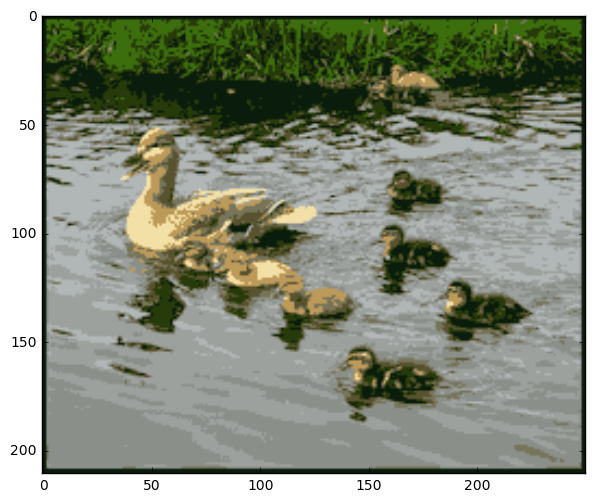

In [9]:
image_name = 'ducks'
image = images[image_name]
coeff = 0.1
n_clusters = 10
random_state = 1
labels, cluster_centers = clusterize_kmeans(image, coeff, n_clusters=n_clusters, random_state=random_state)
plt.figure(figsize=(7, 7))
visualize_filled(image, labels, cluster_centers)

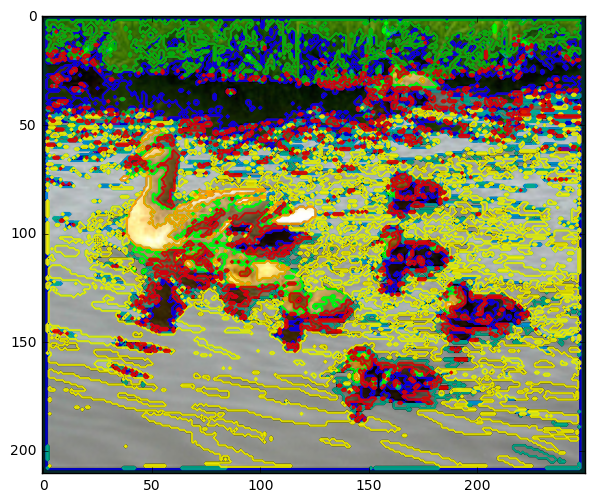

In [173]:
coeff = 0.1
n_clusters = 10
labels, cluster_centers = clusterize_kmeans(image, coeff, n_clusters=n_clusters, random_state=random_state)
plt.figure(figsize=(7, 7))
visualize_contour(image, labels)

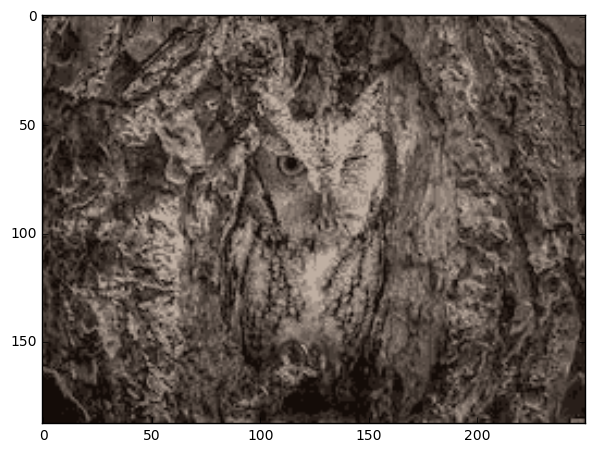

In [175]:
image_name = 'owl'
image = images[image_name]
coeff = 0.1
n_clusters = 10
random_state = 1
labels, cluster_centers = clusterize_kmeans(image, coeff, n_clusters=n_clusters, random_state=random_state)
plt.figure(figsize=(7, 7))
visualize_filled(image, labels, cluster_centers)

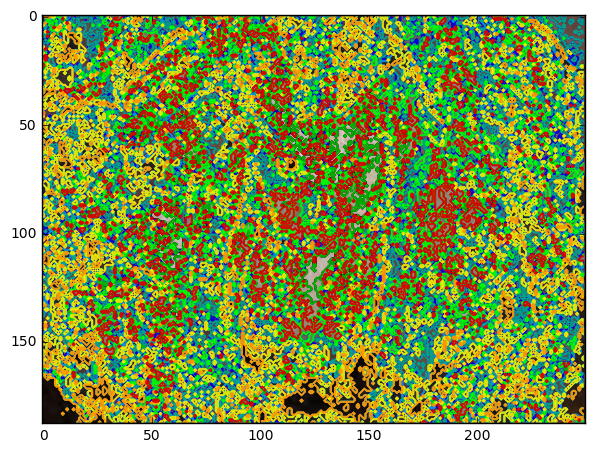

In [176]:
coeff = 0.1
n_clusters = 10
labels, cluster_centers = clusterize_kmeans(image, coeff, n_clusters=n_clusters, random_state=random_state)
plt.figure(figsize=(7, 7))
visualize_contour(image, labels)

При кластеризации совы что-то явно пошло не так...

Стоит отметить, что кластеризация изображения с помощью алгоритма KMeans может применяться для сжатия изобржения с потерями: цвет каждого пикселя заменяется на цвет цента кластера, которому этот пиксель отнесен алгоритмом кластеризации. При этом, однако, безвозвратно теряется информация об истинных значениях цветов пикселей

#### Использование Spectral Clustering
Для ускорения работы алгоритма оба изображения предварительно сжаты в 2 раза переведены в черно-белую цветовую схему.

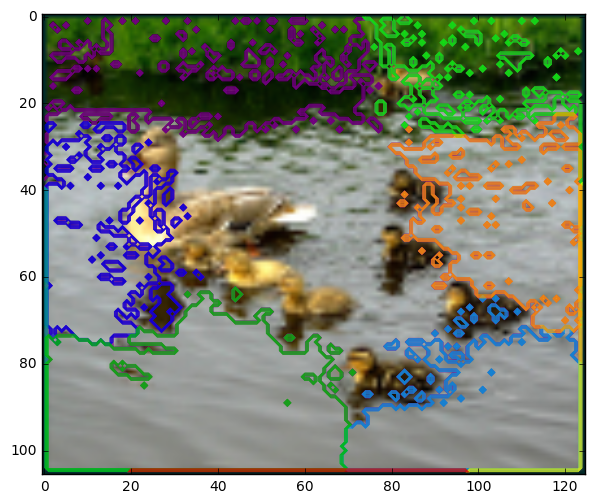

In [79]:
image_name = 'ducks'
image = images[image_name]
n_clusters = 10
image_scaled = transform.rescale(image, scale=0.5)
image_gray = color.rgb2gray(image_scaled)
labels = clusterize_spectral(image_gray, n_clusters=n_clusters, random_state=1)
plt.figure(figsize=(7, 7))
visualize_contour(image_scaled, labels)

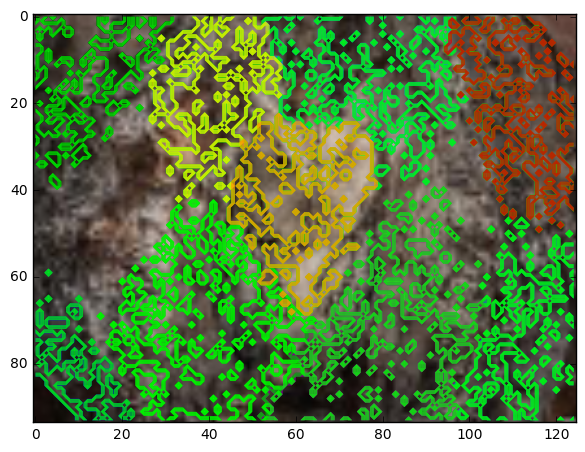

In [80]:
image_name = 'owl'
image = images[image_name]
n_clusters = 10
image_scaled = transform.rescale(image, scale=0.5)
image_gray = color.rgb2gray(image_scaled)
labels = clusterize_spectral(image_gray, n_clusters=n_clusters, random_state=1)
plt.figure(figsize=(7, 7))
visualize_contour(image_scaled, labels)

<a id='seg_task2'></a>
### 2.2 Задание 2 [1 балл]. Варьирование параметров алгоритмов.<sup>[содержание](#table_of_contents)</sup>
Поэкспериментируйте с параметрами алгоритмов. Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

Итак, задача данного раздела состоит в рассмотрении влияния различных параметров алгоритмов кластеризаций KMeans и Spectral Clustering на результаты сегментации изоражений. Прежде всего определимся с тем, варьирование каких именно параметров представляет интерес. 

Если говорить об общих для двух алгоритмов параметрах, то это в первую очередь значения n_clusters и $\lambda$ (в коде это переменная coeff). Что касается алгоритма KMeans, то в целом диапазон представляющих интерес параметров этим скромным множеством и исчерпывается. А вот с Spectral Clustering можно дополнительно рассмотреть параметр assign_labels.


**Немного об организации процесса вычислений.**
* Для KMeans варьируются параметры n_clusters и $\lambda$
* Для Spectral Clustering варьируются параметры n_clusters, $\lambda$, assign_labels и beta. Последний параметр участвует в формировании графа изображения.
Так как процесс вычисления довольно долгий по времени, то результаты кластеризации будут сохраняться в файлы kmeans_labels.pkl и spectral_labels.pkl соответственно.

#### 2.2.1 Варьирование параметров KMeans<sup>[содержание](#table_of_contents)</sup>

In [15]:
filename = 'kmeans_labels.pkl'
if os.path.isfile(filename):
    print('File {} is found. Reading this file.'.format(filename))
    file = open(filename, 'rb')
    precomputed_kmeans_labels = pkl.load(file)
else:
    print('File {} is not found. Starting calculations.'.format(filename))
    n_clusters_range = range(4, 11)
    coeff_range = np.linspace(0, 1, 3)
    random_state = 1
    precomputed_kmeans_labels = defaultdict(dict)
    for image_name in images:
        image = images[image_name]
        for n_clusters, coeff in product(n_clusters_range, coeff_range):
            print('image = {}, n_clusters = {}, coeff = {}'.format(image_name, n_clusters, coeff))
            labels, cluster_centers = clusterize_kmeans(image, coeff, n_clusters=n_clusters, random_state=random_state)
            precomputed_kmeans_labels[image_name][(n_clusters, coeff)] = labels
            
    file = open(filename, 'wb')
    pkl.dump(precomputed_kmeans_labels, file)
    print('Results are written into file {}.'.format(filename))

File kmeans_labels.pkl is found. Reading this file.


Визуализация KMeans кластеризации для изображения ducks.jpg

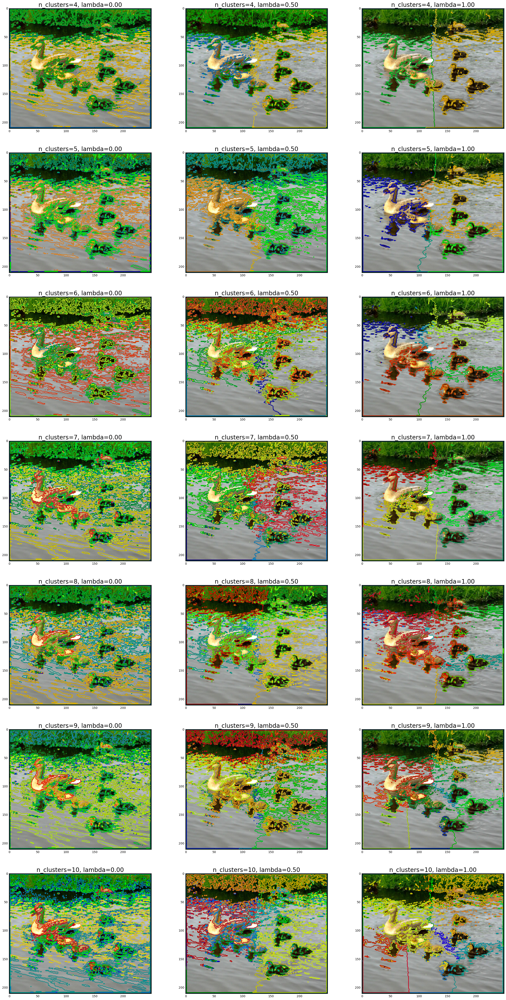

In [18]:
image_name = 'ducks'
image = images[image_name]

n_cols = 3
n_clusterizations = len(n_clusters_range) * len(coeff_range)
n_rows = int(np.ceil(n_clusterizations / n_cols))

dpi = 25
height_inches = image.shape[0] / dpi
width_inches = image.shape[1] / dpi
plt.figure(figsize=(n_cols * width_inches, n_rows * height_inches)) 

for n_clusterization, (n_clusters, coeff) in enumerate(sorted(precomputed_kmeans_labels[image_name])):
    labels = precomputed_kmeans_labels[image_name][(n_clusters, coeff)]
    plt.subplot(n_rows, n_cols, n_clusterization + 1)
    visualize_contour(image, labels)
    title = 'n_clusters={:d}, lambda={:.2f}'.format(n_clusters, coeff)
    plt.title(title, fontsize=20)

Визуализация KMeans кластеризации для изображения owl.jpg

In [ ]:
image_name = 'owl'
image = images[image_name]

n_cols = 3
n_clusterizations = len(precomputed_kmeans_labels[image_name])
n_rows = int(np.ceil(n_clusterizations / n_cols))

dpi = 25
height_inches = image.shape[0] / dpi
width_inches = image.shape[1] / dpi
plt.figure(figsize=(n_cols * width_inches, n_rows * height_inches)) 

for n_clusterization, (n_clusters, coeff) in enumerate(sorted(precomputed_kmeans_labels[image_name])):
    labels = precomputed_kmeans_labels[image_name][(n_clusters, coeff)]
    plt.subplot(n_rows, n_cols, n_clusterization + 1)
    visualize_contour(image, labels)
    title = 'n_clusters={:d}, coeff={:.2f}'.format(n_clusters, coeff)
    plt.title(title, fontsize=20)

#### 2.2.2 Варьирование параметров Spectral Clustering<sup>[содержание](#table_of_contents)</sup>

In [87]:
filename = 'spectral_labels.pkl'
if os.path.isfile(filename):
    print('File {} is found. Reading this file.'.format(filename))
    file = open(filename, 'rb')
    precomputed_spectral_labels = pkl.load(file)
else:
    print('File {} is not found. Starting calculations.'.format(filename))
    n_clusters_range = range(4, 11)
    beta_range = np.linspace(1, 5, 5)
    assign_labels_range = ['kmeans', 'discretize']

    random_state = 1
    precomputed_spectral_labels = defaultdict(dict)
    for image_name in images:
        image = images[image_name]
        image = transform.rescale(image, 0.5)
        image_gray = color.rgb2gray(image)
        for n_clusters, beta, assign_labels in product(n_clusters_range, beta_range, assign_labels_range):
            print('image = {}, n_clusters = {}, beta = {}, assign_labels = {}'.format(
                   image_name, n_clusters, beta, assign_labels))
            labels = clusterize_spectral(image_gray, beta=beta, n_clusters=n_clusters, random_state=random_state,
                                         assign_labels=assign_labels)
            precomputed_spectral_labels[image_name][(n_clusters, beta, assign_labels)] = labels
    file = open('spectral_labels.pkl', 'wb')
    pkl.dump(precomputed_spectral_labels, file)

File spectral_labels.pkl is not found. Starting calculations.
image = owl, n_clusters = 4, beta = 1.0, assign_labels = kmeans
image = owl, n_clusters = 4, beta = 1.0, assign_labels = discretize
image = owl, n_clusters = 4, beta = 2.0, assign_labels = kmeans
image = owl, n_clusters = 4, beta = 2.0, assign_labels = discretize
image = owl, n_clusters = 4, beta = 3.0, assign_labels = kmeans
image = owl, n_clusters = 4, beta = 3.0, assign_labels = discretize
image = owl, n_clusters = 4, beta = 4.0, assign_labels = kmeans
image = owl, n_clusters = 4, beta = 4.0, assign_labels = discretize
image = owl, n_clusters = 4, beta = 5.0, assign_labels = kmeans
image = owl, n_clusters = 4, beta = 5.0, assign_labels = discretize
image = owl, n_clusters = 5, beta = 1.0, assign_labels = kmeans
image = owl, n_clusters = 5, beta = 1.0, assign_labels = discretize
image = owl, n_clusters = 5, beta = 2.0, assign_labels = kmeans
image = owl, n_clusters = 5, beta = 2.0, assign_labels = discretize
image = owl, n

In [ ]:
image_name = 'ducks'
image = images[image_name]
image = transform.rescale(image, 0.5)

n_cols = 2
n_clusterizations = len(precomputed_spectral_labels[image_name])
n_rows = int(np.ceil(n_clusterizations / n_cols))

dpi = 25
height_inches = image.shape[0] / dpi
width_inches = image.shape[1] / dpi
plt.figure(figsize=(n_cols * width_inches, n_rows * height_inches)) 

for n_clusterization, (n_clusters, beta, assign_labels) in enumerate(
    sorted(precomputed_spectral_labels[image_name])):
    labels = precomputed_spectral_labels[image_name][(n_clusters, beta, assign_labels)]
    plt.subplot(n_rows, n_cols, n_clusterization + 1)
    visualize_contour(image, labels)
    title = 'n_cl={:d}, beta={:.2f}, assign={}'.format(n_clusters, beta, assign_labels)
    plt.title(title, fontsize=10)

In [ ]:
image_name = 'owl'
image = images[image_name]
image = transform.rescale(image, 0.5)

n_cols = 2
n_clusterizations = len(precomputed_spectral_labels[image_name])
n_rows = int(np.ceil(n_clusterizations / n_cols))

dpi = 25
height_inches = image.shape[0] / dpi
width_inches = image.shape[1] / dpi
plt.figure(figsize=(n_cols * width_inches, n_rows * height_inches)) 

for n_clusterization, (n_clusters, beta, assign_labels) in enumerate(
    sorted(precomputed_spectral_labels[image_name])):
    labels = precomputed_spectral_labels[image_name][(n_clusters, beta, assign_labels)]
    plt.subplot(n_rows, n_cols, n_clusterization + 1)
    visualize_contour(image, labels)
    title = 'n_cl={:d}, beta={:.2f}, assign={}'.format(n_clusters, beta, assign_labels)
    plt.title(title, fontsize=10)

**Выводы по работе алгоритмов кластеризации KMeans и Spectral Clustering.**

Кластеры, полученные с помощью алгоритма KMeans могут состоять из несвязных областей на изображении, имеющих схожий цвет. Однако с увеличением параметра $\lambda$ растет вес пространственных координат в кластеризации. В результате уменьшается пространственная "раздробленность" кластеров, а при достаточно больших значениях $\lambda$ прямоугольная область изображения будет делиться на n_clusters областей приблизительно одной площади, что, впрочем, становится заметно уже при $\lambda=1$.

Спектральная кластеризации выделяет разрезы в графе, полученном из изображения. Если assign_labels равен discrete, т.е. используется дискретная стратегия, один кластер представляет собой связную область изображения, причем разделяющая линия при уменьшении параметра beta выпрямляется. Если же assign_labels = 'kmeans', то результаты спектарльной кластеризации становятся похожи на результаты работы алгоритма KMeans при больших значениях $\lambda$.

Что же касается контуры объектов, то они далеко не всегда хорошо различимы. В частности, отражение утят в воде зачастую попадает в один кластер с самими изображениями утят (особенно хорошо заметно при использовании алгоритма KMeans). В случае изображения совы, которая сильно сливаетс с фоном, определить ее очертания на основе лишь информации о цвете не представляется возможным: так, ни с помощью алгоритма KMeans, ни с помощью Spectral Clustering выделить контур совы не удалось. 

<a id='tematic_modeling'></a>
# 3. Тематическое моделирование<sup>[содержание](#table_of_contents)</sup>

![](http://imgur.com/S8WgwBp.png)

<a id='discussion_on_topic_modeling'></a>
### 3.1 Рассуждения на тему тематического моделирования<sup>[содержание](#table_of_contents)</sup>

Тематическое моделирование является популярным инструментом анализа текстов. Задача заключается в поиске тем $T$, которые хорошо бы описывали документы $D$ со словарём $W$. Большинство тематических моделей оперирует данными в формате "мешка слов", т.е. учитывают только частоты слов в документах, а не их порядок. Одной из простейших тематических моделей является [PLSA](https://en.wikipedia.org/wiki/Probabilistic_latent_semantic_analysis), которая приводит к задаче стохастического матричного разложения: 

$$F \approx \Phi \times \Theta$$
где
- $F_{W \times D}$— матрица распределений слов в документах (нормированные частоты)
- $\Phi_{W \times T}$ — матрица распределений слов в темах (модель)
- $\Theta_{T \times D}$ — матрица распределений тем в документах (результат применения модели к обучающим данным)

Можно сказать, что алгоритмы тематического моделирования производят мягкую бикластеризацию данных:
 - *мягкую*, так как объекты относятся не строго к одному кластеру, а к нескольким с разными вероятностями
 - *бикластеризацию*, так как модель одновременно кластеризует слова по темам и темы по документам.

#### 3.1.1 EM-алгоритм

![](http://imgur.com/EeIuI1T.png)

С вероятностной точки зрения, задача обучения модели PLSA ставится как максимизация неполного правдоподобия по параметам $\Phi$ и $\Theta$. ЕМ-алгоритм для модели PLSA заключается в повторении двух шагов:

- **Е-шаг** — оценка распределений тем для каждого слова в каждом документе по параметрам $\Phi$ и $\Theta$ (шаг 6);
- **М-шаг** — обновление параметров $\Phi$ и $\Theta$ на основе полученных оценок (шаги 7 и 9).

Существуют различные модификации итерационного процесса, позволяющие снизить расходы по памяти. В данном случае, мы избегаем хранения трехмерной матрицы $p_{tdw}$, сразу пересчитывая $\Theta$ для текущего документа и аккумулируя счетчики $n_{wt}$ для последующего пересчета $\Phi$.

Псевдокод алгритма записывается следующим образом:

1. Инициализировать $\phi_{wt}^0$ для всех $w \in W$, $t \in T$ и $\theta_{td}^0$ для всех $t \in T$, $d \in D$
2. Внешний цикл по итерациям $i = 1 ... max\_iter$:
3. $\quad$ $n_{wt}^i := 0$, $n_t^i := 0$ для всех $w \in W$ и $t \in T$ 
4. $\quad$ Внутренний цикл по документам $d \in D$  
5. $\qquad$ $Z_w := \sum_{t \in T} \phi_{wt}^{i-1}\theta_{td}^{i-1}$ для всех $w \in d$ $\cfrac{}{}$
6. $\qquad$ $p_{tdw} := \cfrac{ \phi_{wt}^{i-1}\theta_{td}^{i-1} }{ Z_w }$ (**E-шаг**)
7. $\qquad$ $\theta_{td}^{i} := \cfrac{ \sum_{w \in d} n_{dw} p_{tdw} }{ n_d }$ для всех $t \in T$ (**M-шаг**)
8. $\qquad$ Увеличить $n_{wt}^i$ и $n_t^i$ на $n_{dw} p_{tdw}$ для всех $w \in W$ и $t \in T$
9. $\quad \phi_{wt}^i := \cfrac{n_{wt}^i}{n_t^i}$ для всех $w \in W$ и $t \in T$ (**M-шаг**)

Обозначения:
 - $p_{tdw}$ — вероятность темы $t$ для слова $w$ в документе $d$
 - $\phi_{wt}$ — элемент матрицы $\Phi$, соответствующий вероятности слова $w$ в теме $t$
 - $\theta_{td}$ — элемент матрицы $\Theta$, соответствующий вероятности темы $t$ в документе $d$
 - $n_{wt}$ — элемент матрицы счётчиков отнесения слова $w$ к теме $t$ (путем нормирования этой матрицы получается матрица $\Phi$)
 - $Z_w$ — элемент вектора вспомогательных переменных, соответствующий слову $w$
 - $n_t$ — вектор нормировочных констант для матрицы $n_{wt}$
 - $n_d$ — вектор нормировочных констант для матрицы $n_{dw}$
 - $n$ — суммарное число слов в коллекции



#### 3.1.2  Оценка качества

Для оценивания качества построенной модели и контроля сходимости процесса обучения обычно используют [перплексию](http://www.machinelearning.ru/wiki/images/8/88/Voron-iip9-talk.pdf):

$$\mathcal{P} = \exp\bigg(- \frac{\mathcal{L}}{n} \bigg) = \exp\bigg(- \cfrac{1}{n}\sum_{d \in D}\sum_{w \in d} n_{dw} \ln \big(\sum_{t \in T}\phi_{wt}\theta_{td} \big)\bigg)$$

Это традиционная мера качества в тематическом моделировании, которая основана на правдоподобии модели $\mathcal{L}$. Число итераций $max\_iter$ в алгоритме обучения следует выбирать достаточным для того, чтобы перплексия перестала существенно убывать. Однако известно, что перплексия плохо отражает интерпретируемость найденных тем, поэтому помимо нее обычно используются дополнительные меры или экспертные оценки.

Загрузите [коллекцию писем Х. Клинтон](https://www.kaggle.com/kaggle/hillary-clinton-emails/downloads/hillary-clinton-emails-release-2015-09-11-01-39-01.zip) с kaggle. Для скачивания может потребоваться регистрация.

Извлеките полные тексты писем из файла *Emails.csv* и подготовьте данные в формате "мешка слов" с помощью функции  [CountVectorizer](http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html) пакета sklearn. Рекомендуется произвести фильтрацию слов по частотности для удаления слишком редких и стоп-слов (рекомендованный нижний порог в пределах 10 и верхний 400-600).

In [20]:
raw_data = pd.read_csv('emails/Emails.csv')
emails = list(raw_data['RawText'])
vectorizer = CountVectorizer(min_df=10, max_df=500, stop_words='english')
DW = vectorizer.fit_transform(emails)

word2number = {}
number2word = {}
for word, number in vectorizer.vocabulary_.items():
    word2number[word] = number
    number2word[number] = word

Как оказывается, есть такие тексты, векторное представление которых содержит только нули. Эти тексты нужно убрать, так как по существу они бессмысленны.

In [1]:
print(DW.shape)
if np.sum(DW.sum(1) == 0):
    indices = np.where(DW.sum(1) == 0)[0]
    mask = np.ones(DW.shape[0])
    mask[indices] = False
    indices = np.flatnonzero(mask)
    DW = DW[indices]
print(DW.shape)

NameError: name 'DW' is not defined

<a id='plsa_and_application'></a>
### 3.2 Реализация ЕМ-алгоритма для модели PLSA и его применение<sup>[содержание](#table_of_contents)</sup>

In [22]:
def calculate_perplexity(n_dw, Phi, Theta):
    "Возвращает логарифм перплексии"
    D, W = n_dw.shape
    N = n_dw.sum()
    perplexity = 0
    for d in range(D):
        P_dw = np.dot(Phi, Theta[:, d].reshape((-1, 1)))
        n_d = n_dw[d].todense()
        P_dw[P_dw == 0] = 1e-10
        perplexity += np.sum(n_d * np.log(P_dw)) / N
    return -perplexity

In [23]:
def PLSA(n_dw, T, max_iter, init='uniform', seed=1, verbose=True):
    n_d = n_dw.sum(axis=1).A1
    D, W = n_dw.shape
    N = n_dw.sum()
    history = []
    
    if init == 'uniform':
        Phi = np.full((W, T), 1.0 / W)
        Theta = np.full((T, D), 1.0 / T)
    elif init == 'random':
        np.random.seed(seed)
        Phi = np.random.rand(W, T)
        Theta = np.random.rand(T, D)
        Phi = normalize(Phi, norm='l1', axis=0)
        Theta = normalize(Theta, norm='l1', axis=0)
    else:
        raise ValueError('unknown value of init')
    
    for i in range(max_iter):
        H_wt = np.zeros((W, T))
        perplexity = 0
        for d in range(D):
            P_dw = np.dot(Phi, Theta[:, d].reshape((-1, 1)))
            P_dwt = np.multiply(Phi, Theta[:, d])

            if np.sum(P_dw == 0):
                P_dw[P_dw == 0] = 1e-10 # To avoid division by zero
                P_dw /= np.sum(P_dw)
            P_dwt = np.divide(P_dwt, P_dw)

            row = n_dw.getrow(d).todense().reshape((-1, 1))
            H_dwt = np.multiply(P_dwt, row)
            Theta[:, d] = H_dwt.sum(axis=0) / n_d[d]
            H_wt += H_dwt
            perplexity += np.sum(np.multiply(row, np.log(P_dw)) / N)
        Phi = np.divide(H_wt, H_wt.sum(0))
        history.append((i, -perplexity))
        if verbose:
            print(i, -perplexity)
    return Phi, Theta, history

<a id='plsa_task1'></a>
### 3.2.1 Задание 1 [3 балла]<sup>[содержание](#table_of_contents)</sup>
Примените ваш алгоритм к подготовленным данным, рассмотрите число тем T = 5. Постройте график значения перплексии в зависимости от итерации (убедитесь в корректности реализации: график перплексии должен быть невозрастающим). Выведите для каждой темы топ-20 наиболее вероятных слов.

#### 3.2.1.1  Применение алгоритма к подготовленным данным для числа тем T = 5. Построение графика зависимости значения перплексии в зависимости от итерации.

In [24]:
T = 5
max_iter = 100
init = 'random'
seed = 11
Phi, Theta, history = PLSA(DW, T, max_iter, init)
perplexity = calculate_perplexity(DW, Phi, Theta)
history.append((max_iter, perplexity))

0 9.26084365811
1 8.44826011611
2 8.43639897746
3 8.42385304804
4 8.40831292037
5 8.3884614414
6 8.36417533522
7 8.33683518834
8 8.30850236042
9 8.28064993131
10 8.25386907159
11 8.22858026737
12 8.20525413728
13 8.18428413797
14 8.16606263232
15 8.15055739873
16 8.13734492087
17 8.12603531854
18 8.11632374003
19 8.10793722077
20 8.10072802108
21 8.09454561944
22 8.0892030204
23 8.08453479539
24 8.08033968105
25 8.07657481415
26 8.07324079048
27 8.07019094992
28 8.06740260863
29 8.06488865752
30 8.06263009382
31 8.06062024943
32 8.05878527779
33 8.0570620572
34 8.05542661947
35 8.05387859008
36 8.0524167048
37 8.05102207223
38 8.04967597884
39 8.04838943443
40 8.04717023242
41 8.04599336819
42 8.04481435646
43 8.04363194633
44 8.04250296842
45 8.04142457912
46 8.04035891966
47 8.03928380983
48 8.03822636041
49 8.03721300632
50 8.03621883953
51 8.03521521605
52 8.0342011007
53 8.03319734493
54 8.03224403167
55 8.03134056195
56 8.03047987089
57 8.02963551656
58 8.02876832435
59 8.0278822

In [2]:
x = [x[0] for x in history]
y = [y[1] for y in history]
plt.plot(x, y)
plt.grid()
plt.title('Perplextiy vs PLSA iteration')
plt.xlabel('iteration')
plt.ylabel('$\log(\mathcal{P})$')

NameError: name 'history' is not defined

#### 3.2.1.2 Вывод 20 наиболее вероятных слов для каждой темы.

In [26]:
def get_max_indices(values, n_max):
    values = [[i, x] for i, x in enumerate(values)]
    values = sorted(values, key=lambda x: -x[1])
    indices = [i for i, x in values[:n_max]]
    return np.array(indices)

def get_representatives(Phi, n_max):
    representatives = pd.DataFrame()
    for topic in range(Phi.shape[1]):
        words = [number2word[i] for i in get_max_indices(Phi[:, topic], max_words)]
        representatives[topic] = words
    return representatives

In [27]:
max_words = 20
representatives = get_representatives(Phi, max_words)
print(representatives)

              0            1            2           3          4
0        israel        haiti       senate    benghazi     lauren
1   afghanistan  development        party   sensitive     jiloty
2          iran       global        white        dept       lona
3         peace        china   republican    produced    valmoro
4       israeli        women         vote      select     update
5           war       africa     election      waiver   valmorou
6            mr         room  republicans        comm      draft
7      pakistan          aid        verma        foia  netanyahu
8          iraq   assistance      percent  redactions       anne
9        afghan     economic           mr       04841         b1
10      nuclear       health         care       libya      calls
11      america    diplomacy    democrats        2012        jun
12     official           en       health          al        oct
13       turkey         food      senator      libyan        dec
14           ap       arr

<a id='plsa_task2'></a>
### 3.2.2 Задание 2 [0.5 балла]<sup>[содержание](#table_of_contents)</sup>
Рассмотрите число тем T = 10, 20. Сравните между собой топ-20 наиболее вероятных слов в каждой теме (а также для модели, полученной ранее). Можно ли сказать, что конкретность каждой темы изменяется с ростом их числа?

#### 3.2.2.1 Применение алгоритма для числа тем T = 10. Вывод топ-20 наиболее вероятных слов для каждой темы.

In [41]:
T = 10
max_iter = 100
init = 'random'
seed = 11
Phi10, Theta10, history10 = PLSA(DW, T, max_iter, init)
perplexity = calculate_perplexity(DW, Phi10, Theta10)
history10.append((max_iter, perplexity))

0 9.25386814159
1 8.45604078102
2 8.44259323234
3 8.42609567067
4 8.40315037538
5 8.3706979432
6 8.32712573804
7 8.2741731143
8 8.21757440413
9 8.16398628814
10 8.11743396756
11 8.07866399919
12 8.04647187679
13 8.01955636143
14 7.99699490158
15 7.97807733928
16 7.96214352813
17 7.94861936986
18 7.93713176956
19 7.92733119009
20 7.91890976617
21 7.9115878643
22 7.905120117
23 7.89931285207
24 7.89406316409
25 7.88926656782
26 7.88485274959
27 7.88079034215
28 7.87705546928
29 7.87358387343
30 7.87032892085
31 7.86733335865
32 7.86458216944
33 7.86201229753
34 7.85963929449
35 7.85743593188
36 7.85535719133
37 7.85340303182
38 7.8515895523
39 7.84986961576
40 7.84822549728
41 7.84669774816
42 7.84531090649
43 7.84405041631
44 7.84285678598
45 7.84172076821
46 7.84062347905
47 7.83953912001
48 7.83849790361
49 7.837509065
50 7.83656060798
51 7.83566575458
52 7.83478711124
53 7.83394438562
54 7.83314186455
55 7.8323449854
56 7.83154909867
57 7.830769744
58 7.8299863585
59 7.82924907787
60

In [43]:
max_words = 20
representatives = get_representatives(Phi10, max_words)
print(representatives)

              0             1          2           3            4          5  \
0   development        israel      haiti    benghazi     pakistan     lauren   
1    assistance       israeli     senate   sensitive  afghanistan     jiloty   
2         human         peace       room        dept       afghan     update   
3        rights          iran         en    produced           af      calls   
4     diplomacy   palestinian     arrive      select      embassy     letter   
5        africa     netanyahu     depart      waiver       police   honduras   
6        global           ses      route        comm         iraq        ops   
7      economic       reuters       vote        foia      taliban      verma   
8        future       nuclear       anne  redactions        kabul     zelaya   
9       nations         prime      marie       04841       forces       list   
10     strategy         talks      white       libya          aid      craig   
11     programs            ap    haitian

#### 3.2.2.2 Применение алгоритма для числа тем T = 20. Вывод топ-20 наиболее вероятных слов для каждой темы.

In [44]:
T = 20
max_iter = 100
init = 'random'
seed = 11
Phi20, Theta20, history20 = PLSA(DW, T, max_iter, init)
perplexity = calculate_perplexity(DW, Phi20, Theta20)
history20.append((max_iter, perplexity))

0 9.23376290542
1 8.45323160744
2 8.43907684103
3 8.42021467373
4 8.39184145222
5 8.34852621522
6 8.28653269949
7 8.20796863386
8 8.12191184362
9 8.03900764329
10 7.96562275897
11 7.90330726684
12 7.85122675776
13 7.8084916597
14 7.7739699099
15 7.7460948519
16 7.72349122133
17 7.70498967594
18 7.68969050461
19 7.6768950193
20 7.66598281855
21 7.6565147379
22 7.64824256567
23 7.64100334515
24 7.63466389572
25 7.62910535366
26 7.62423722341
27 7.61997310287
28 7.61621441064
29 7.61287360245
30 7.60991041784
31 7.60723570096
32 7.60479304773
33 7.60253452536
34 7.6004439449
35 7.59849025935
36 7.59666664968
37 7.59494768384
38 7.59333947956
39 7.59185210456
40 7.59046297137
41 7.58917446163
42 7.58797968353
43 7.58684799582
44 7.58577244262
45 7.58477623478
46 7.58384898085
47 7.58296451938
48 7.58211566134
49 7.58131320464
50 7.58055563027
51 7.57981006413
52 7.57909210765
53 7.5784052613
54 7.57775006629
55 7.57710605194
56 7.57646505391
57 7.57584521146
58 7.57523790116
59 7.574626508

In [45]:
max_words = 20
representatives = get_representatives(Phi20, max_words)
print(representatives)

           0         1            2           3          4         5   \
0        iran        uk           mr        anne       lona    lauren   
1      rights      deal  afghanistan       marie     senate    jiloty   
2       human       sid   mcchrystal       draft    valmoro       ses   
3     nuclear     party         iraq   slaughter   valmorou   reuters   
4     freedom     brown        blair      update    senator        ap   
5      africa    gordon     decision       lissa       vote  mahogany   
6      russia   cameron      goldman   muscatine      verma      list   
7      future        co          war     crowley       reid   o_shift   
8   democracy   ireland       troops      strobe  committee       wjc   
9        iraq  sbwhoeop    brazilian  slaughtera  assistant    branch   
10     berlin       dup       family      philip   senators       nov   
11    defense  guardian         sean   mashabane        mtg        de   
12    iranian  northern         bush      lauren   

В целом, с ростом числа тем растет интерпретируемость полученных результатов, т.е. растет все большему числу тем можно поставить в соответствие некую метку. Например, найденным выше группам топ-20 наиболее вероятных слов можно присвоить следующие метки: "политика", "дипломатия", "военные действия", "безопасность", "Персидский Залив", "гуманитарная помощь", "проживаение и путешествие" (тема 6 для T = 20) и т.п.

<a id='plsa_task3'></a>
### 3.2.3 Задание 3 [0.5 балла]<sup>[содержание](#table_of_contents)</sup>
Протестируйте модель для разных начальных приближений. Что можно сказать об устойчивости алгоритма (идентичны ли топовые слова в соответствующих темах моделей)?

Ниже модель запускается для 4-х различных значений "зерна" генератора случайных чисел. Число тем равно 10, а число итераций выбрано равным 40. Во всех случаях топовые слова в темах совпали. Таким образом, можно утверждать, что алгоритм PLSA достаточно устойчив к выбору начальных приближений.

In [15]:
T = 10
max_iter = 40
max_words = 20
init = 'random'
representatives = {}
for seed in range(1, 5):
    Phi, Theta, history = PLSA(DW, T, max_iter, init, verbose=False, seed=seed)
    representatives[seed] = get_representatives(Phi, max_words)

In [49]:
for seed in range(1, 5):
    print('For seed', seed)
    print(representatives[seed])
    print('\n')

For seed 1
              0             1            2           3            4         5  \
0   development        israel        haiti    benghazi  afghanistan    lauren   
1    assistance       israeli       senate   sensitive     pakistan    jiloty   
2         human         peace         room        dept       afghan    letter   
3        rights   palestinian         vote    produced           af    update   
4      economic           ses        white      select         iraq     calls   
5        future            ap         anne      waiver    diplomacy  honduras   
6        africa         prime  republicans        comm      taliban       ops   
7       percent       reuters           en        foia       police     verma   
8       nations         talks   republican  redactions      affairs       dec   
9        agency     netanyahu        marie       04841        local      list   
10      service  palestinians       arrive       libya        kabul    zelaya   
11      million  

<a id='lda_and_visualization'></a>
### 3.3 Модель LDA и визуализация<sup>[содержание](#table_of_contents)</sup>

Модель [LDA](https://en.wikipedia.org/wiki/Latent_Dirichlet_allocation) является наиболее популярной тематической моделью. Единственное отличие от модели PLSA заключается в введении априорных распределений Дирихле на столбцы матриц $\Phi$ и $\Theta$, которое может способствовать дополнительному сглаживанию или разреживанию параметров.

В этом задании предлагается воспользоваться реализацией модели [LdaModel](https://radimrehurek.com/gensim/models/ldamodel.html), обучение которой основано на вариационном байесовском выводе. Для выполнения задания вам потребуется установить пакеты [gensim](https://radimrehurek.com/gensim/install.html) и [pyldavis 2.0](https://pyldavis.readthedocs.io/en/latest/readme.html#installation).

Подготовьте данные в формате, подходящем для *gensim* (полное API gensim можно найти [здесь](https://radimrehurek.com/gensim/apiref.html)). Пример обработки вывода *CountVectorizer* для gensim можно найти [здесь](https://gist.github.com/aronwc/8248457).

<a id='lda_task1'></a>
### 3.3.1 Задание 1 [1 балла]<sup>[содержание](#table_of_contents)</sup>

Примените [LdaModel](https://radimrehurek.com/gensim/models/ldamodel.html) к подготовленным данным (рекомендуется задать заведомо большое число итераций в параметре *passes*, например, 30). Визуально сравните полученные темы по топ-20 наиболее вероятным словам с темами, полученными вашей реализацией ЕМ-алгоритма. У какой из моделей получились более интерпретируемые темы?

In [92]:
from gensim.models.ldamodel import LdaModel
from gensim import matutils

raw_data = pd.read_csv('emails/Emails.csv')
emails = list(raw_data['RawText'])
vec = CountVectorizer(min_df=10, max_df=500, stop_words='english')
X = vec.fit_transform(emails)
word2number = {}
number2word = {}
for word, number in vec.vocabulary_.items():
    word2number[word] = number
    number2word[number] = word
    
num_topics = 10
passes = 40

corpus = matutils.Sparse2Corpus(X.tocoo().transpose().tocsc())
lda = LdaModel(corpus, num_topics=num_topics,
               passes=passes, id2word=dict([(i, s) for i, s in enumerate(number2word)]))

In [99]:
def get_lda_representatives(lda, number2word, n):
    representatives = pd.DataFrame()
    topics = lda.show_topics(num_topics=-1, num_words=n, formatted=False)
    for ti, topic in enumerate(topics):
        words = [number2word[x[0]] for x in topic[1]]
        representatives[ti] = words
    return representatives

max_words = 20
representatives = get_lda_representatives(lda, number2word, max_words)
print(representatives)

            0           1         2            3          4            5  \
0        lona    benghazi   embassy       senate      blair        women   
1         feb   sensitive     kelly           mr     turkey  development   
2     valmoro        dept     craig        white   sbwhoeop       global   
3         dec    produced    harold        party     gordon        china   
4       marie      select      iraq  afghanistan    cameron        haiti   
5         jan      waiver   patrick     election         eu     economic   
6        anne        comm    philip   republican       tony    diplomacy   
7    valmorou        foia   kennedy         vote        sid       health   
8          b1  redactions       sbu     campaign     labour          aid   
9       draft       04841    zelaya  republicans     europe       africa   
10      thank       libya   jeffrey    democrats     tories         food   
11  slaughter        2012   crowley       afghan   european   assistance   
12        cd

В целом, оба алгоритма PLSA и LDA выделяют одни и те же темы. Стоит отметить, что какие-то темы лучше выделены в результате применения PLSA, в то время как другие - в результате применения LDA. Однако существенных различий не наблюдается, что может быть связано с достаточно большим размером коллекции текстов.

<a id='lda_task2'></a>
### 3.3.2 Задание  2 [1 балл]<sup>[содержание](#table_of_contents)</sup>
Визуализируйте модель из gensim с помощью ldavis (описание API LDAvis для работы с gensim есть [здесь](http://pyldavis.readthedocs.io/en/latest/modules/API.html)), пример — [здесь](https://github.com/bmabey/pyLDAvis/blob/master/notebooks/pyLDAvis_overview.ipynb).

In [101]:
import pyLDAvis
import gensim
from pyLDAvis.gensim import prepare
corpus = matutils.Sparse2Corpus(X.tocoo().transpose().tocsc())
dictionary = gensim.corpora.Dictionary.from_corpus(corpus, number2word)
print(prepare(lda, corpus, dictionary))

PreparedData(topic_coordinates=            Freq  cluster  topics         x         y
topic                                                
5      21.487342        1       1  0.124277  0.037650
3      13.545336        1       2  0.052514 -0.004274
0      11.702496        1       3 -0.223446 -0.074748
6      11.647859        1       4  0.065031  0.035920
9      10.435748        1       5  0.125659  0.017288
1       9.022943        1       6  0.174978  0.100782
8       8.099467        1       7  0.114655  0.001740
2       5.514449        1       8 -0.063350 -0.051595
4       5.068752        1       9 -0.071283 -0.287752
7       3.475608        1      10 -0.299038  0.224988, topic_info=     Category         Freq        Term        Total  loglift  logprob
term                                                                 
3789  Default  2334.000000    benghazi  2334.000000  30.0000  30.0000
4689  Default  2196.000000   sensitive  2196.000000  29.0000  29.0000
757   Default  1775.000000   

### Рекомендации к выполнению
Для обучения *LdaModel* и её последующей визуализации потребуется словарь формата gensim, который можно получить следующей командой

    dictionary = gensim.corpora.Dictionary.from_corpus(corpora, vocab_dict)

где *corpora* содержит полученное с помощью gensim представление коллекции, а *vocab_dict* — это dict, полученный после работы CountVectorizer, ставящий в соответствие каждому номеру строки в матрице данных само слово в виде строки.